## Importing of Necessary Packages

In [1]:
#importing all the necessary packages
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Data Extraction Process
#### Extracting Necessary Dataset from Datasets file

In [2]:
import zipfile
import os

# Define the path to the zip file and the extraction directory
zip_file_path = 'UberDataset.zip'
extraction_directory = 'UberDataset'

# Create the extraction directory if it doesn't exist
os.makedirs(extraction_directory, exist_ok=True)

# Open the zip file and extract its contents
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extraction_directory)

print(f"Extracted all files to '{extraction_directory}'")

Extracted all files to 'UberDataset'


In [3]:
# Checking datasets
os.listdir('UberDataset\Datasets')

['other-American_B01362.csv',
 'other-Carmel_B00256.csv',
 'other-Dial7_B00887.csv',
 'other-Diplo_B01196.csv',
 'other-Federal_02216.csv',
 'other-FHV-services_jan-aug-2015.csv',
 'other-Firstclass_B01536.csv',
 'other-Highclass_B01717.csv',
 'other-Lyft_B02510.csv',
 'other-Prestige_B01338.csv',
 'other-Skyline_B00111.csv',
 'Uber-Jan-Feb-FOIL.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [4]:
#Extracting dataset
uber_15=pd.read_csv(r'UberDataset\Datasets\uber-raw-data-janjune-15_sample.csv')

## Data Cleaning Process
#### Identifying duplicated Values , Identifying Null Values , transforming date cells into correct type

In [5]:
#Identifying shape
uber_15.shape

(100000, 4)

In [6]:
#Identifying type
type(uber_15)

pandas.core.frame.DataFrame

In [7]:
#Identifying duplicated values
uber_15.duplicated().sum()

54

In [8]:
#dropping duplicated values
uber_15.drop_duplicates(inplace=True)

In [9]:
#Checking Columns datatype
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [10]:
#Checking Null Values
uber_15.isnull().sum()

Dispatching_base_num       0
Pickup_date                0
Affiliated_base_num     1116
locationID                 0
dtype: int64

In [11]:
#Exploring pickup_date column
uber_15['Pickup_date'][0]

'2015-05-02 21:43:00'

In [12]:
#Transforming Pickup_date into datetime format
uber_15['Pickup_date']=pd.to_datetime(uber_15['Pickup_date'])

In [13]:
#Checking time stamp datetime 
uber_15['Pickup_date'].dtypes

dtype('<M8[ns]')

In [14]:
type(uber_15['Pickup_date'][0])

pandas._libs.tslibs.timestamps.Timestamp

In [15]:
#Identifying datatypes of columns
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

# Which Month has most Pickups in New York?
#### Using Barplot to Identify months with most pickups

In [16]:
uber_15['Month']=uber_15['Pickup_date'].dt.month_name()

In [17]:
uber_15['Month']

0            May
1        January
2          March
3          April
4          March
          ...   
99995      April
99996      March
99997      March
99998        May
99999       June
Name: Month, Length: 99946, dtype: object

<AxesSubplot:>

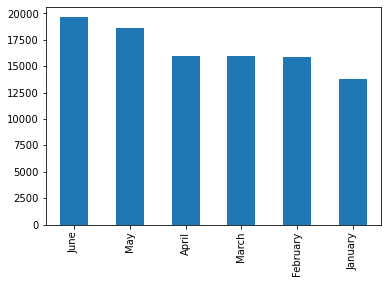

In [18]:
#Visualizing Months with most pickups using barplot
uber_15['Month'].value_counts().plot(kind='bar')

## Which days in months have most pickups in New York ?
#### using Barplots to identify which days with most pickups

In [19]:
#Diving deeper to Identify which days in the months have most pickups
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()
uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['hour']=uber_15['Pickup_date'].dt.hour
uber_15['minute']=uber_15['Pickup_date'].dt.minute

In [20]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,Month,weekday,day,hour,minute
0,B02617,2015-05-02 21:43:00,B02764,237,May,Saturday,2,21,43
1,B02682,2015-01-20 19:52:59,B02682,231,January,Tuesday,20,19,52
2,B02617,2015-03-19 20:26:00,B02617,161,March,Thursday,19,20,26
3,B02764,2015-04-10 17:38:00,B02764,107,April,Friday,10,17,38
4,B02764,2015-03-23 07:03:00,B00111,140,March,Monday,23,7,3


In [21]:
#Crosstabbing for better visualizations by creating a pivot
pivot=pd.crosstab(index=uber_15['Month'],columns=uber_15['weekday'])

In [22]:
pivot

weekday,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
Month,,,,,,,
April,2365,1833,2508,2052,2823,1880,2521
February,2655,1970,2550,2183,2396,2129,2013
January,2508,1353,2745,1651,2378,1444,1740
June,2793,2848,3037,2485,2767,3187,2503
March,2465,2115,2522,2379,2093,2388,2007
May,3262,1865,3519,2944,2627,2115,2328


<AxesSubplot:xlabel='Month'>

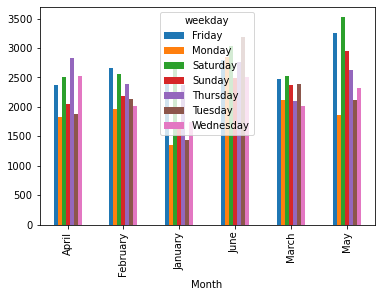

In [23]:
#Visualizing using barplot to answer which days in months have most pickups
pivot.plot(kind='bar')

## What is the rush hours in each day ?

In [24]:
type(uber_15)

pandas.core.frame.DataFrame

In [25]:
summary=uber_15.groupby(['weekday','hour'],as_index=False).size()

In [26]:
summary

,weekday,hour,size
0,Friday,0,581
1,Friday,1,333
2,Friday,2,197
3,Friday,3,138
4,Friday,4,161
...,...,...,...
163,Wednesday,19,1044
164,Wednesday,20,897
165,Wednesday,21,949
166,Wednesday,22,900


#### Using Pointplots to identify rush hours

<AxesSubplot:xlabel='hour', ylabel='size'>

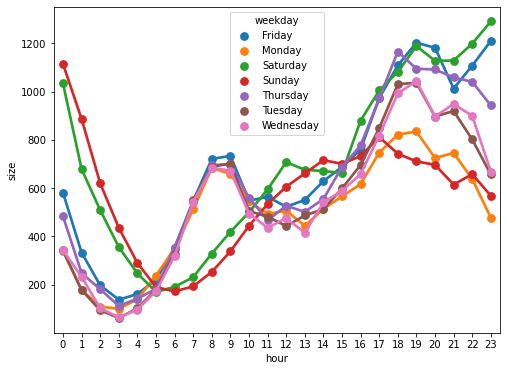

In [27]:
#using pointplot to see weekdays and rush hours and pickups
plt.figure(figsize=(8,6))
sns.pointplot(x="hour",y="size",hue="weekday",data=summary)

## Identifying Basenumber with most active vehicles
#### using Boxplot and Violinplot to identify it 

In [28]:
uber_15.columns

Index(['Dispatching_base_num', 'Pickup_date', 'Affiliated_base_num',
       'locationID', 'Month', 'weekday', 'day', 'hour', 'minute'],
      dtype='object')

In [29]:
uber_foil=pd.read_csv(r'UberDataset\Datasets\Uber-Jan-Feb-FOIL.csv')

In [30]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [31]:
uber_foil.shape

(354, 4)

In [32]:
!pip install chart_studio


[notice] A new release of pip available: 22.3.1 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [33]:
!pip install plotly


[notice] A new release of pip available: 22.3.1 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [34]:
import chart_studio.plotly as py
import plotly.express as px
import plotly.graph_objs as go

In [35]:
from plotly.offline import download_plotlyjs , init_notebook_mode,plot,iplot

In [36]:
init_notebook_mode(connected=True)

In [37]:
uber_foil.columns

Index(['dispatching_base_number', 'date', 'active_vehicles', 'trips'], dtype='object')

In [38]:
px.box(x='dispatching_base_number',y='active_vehicles', data_frame =uber_foil)

In [39]:
px.violin(x='dispatching_base_number',y='active_vehicles', data_frame =uber_foil)

## Collecting Entire data to make it available for data analysis
#### Getting data and dropping duplicate values

In [40]:
files=os.listdir('UberDataset\Datasets')[-8:]

In [41]:
files.remove('uber-raw-data-janjune-15.csv')

In [42]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [43]:
files.remove('uber-raw-data-janjune-15_sample.csv')

In [44]:
final=pd.DataFrame()
path='UberDataset\Datasets'
for file in files:
    current_df=pd.read_csv(path+'/'+file)
    final=pd.concat([current_df,final])

In [45]:
final.shape

(4534327, 4)

In [46]:
final.duplicated().sum()

82581

In [47]:
final.drop_duplicates(inplace=True)

In [48]:
final.shape

(4451746, 4)

In [49]:
final.head(3)

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512


In [50]:
rush_uber=final.groupby(['Lat','Lon'],as_index=False).size()

In [51]:
rush_uber.head(5)

,Lat,Lon,size
0,39.6569,-74.2258,1
1,39.6686,-74.1607,1
2,39.7214,-74.2446,1
3,39.8416,-74.1512,1
4,39.9055,-74.0791,1


## Which Locations in New York are having Rush ?
#### using heatmap to Identify Rush Locations 

In [52]:
import folium

In [53]:
basemap=folium.Map()

In [54]:
basemap

In [55]:
from folium.plugins import HeatMap

In [56]:
HeatMap(rush_uber).add_to(basemap)

In [57]:
basemap

In [58]:
final.columns

Index(['Date/Time', 'Lat', 'Lon', 'Base'], dtype='object')

In [59]:
final.head(3)

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512


In [60]:
final.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [61]:
final['Date/Time'][0]

0    9/1/2014 0:01:00
0    5/1/2014 0:02:00
0    6/1/2014 0:00:00
0    7/1/2014 0:03:00
0    8/1/2014 0:03:00
0    4/1/2014 0:11:00
Name: Date/Time, dtype: object

In [62]:
final['Date/Time']=pd.to_datetime(final['Date/Time'],format="%m/%d/%Y %H:%M:%S")

In [63]:
final['Date/Time'].dtypes

dtype('<M8[ns]')

In [64]:
final['Day']=final['Date/Time'].dt.day
final['Hour']=final['Date/Time'].dt.hour

In [65]:
final.head(4)

,Date/Time,Lat,Lon,Base,Day,Hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,1,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,1,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,1,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,1,0


## Performing Pairwise Analysis to figure out rush

In [66]:
pivot=final.groupby(['Day','Hour']).size().unstack()

In [67]:
pivot

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day,,,,,,,,,,,,,,,,,,,,,
1,3178,1944,1256,1308,1429,2126,3664,5380,5292,4617,...,6933,7910,8633,9511,8604,8001,7315,7803,6268,4050
2,2435,1569,1087,1414,1876,2812,4920,6544,6310,4712,...,6904,8449,10109,11100,11123,9474,8759,8357,6998,5160
3,3354,2142,1407,1467,1550,2387,4241,5663,5386,4657,...,7226,8850,10314,10491,11239,9599,9026,8531,7142,4686
4,2897,1688,1199,1424,1696,2581,4592,6029,5704,4744,...,7158,8515,9492,10357,10259,9097,8358,8649,7706,5130
5,2733,1541,1030,1253,1617,2900,4814,6261,6469,5530,...,6955,8312,9609,10699,10170,9430,9354,9610,8853,6518
6,4537,2864,1864,1555,1551,2162,3642,4766,4942,4401,...,7235,8612,9444,9929,9263,8405,8117,8567,7852,5946
7,3645,2296,1507,1597,1763,2422,4102,5575,5376,4639,...,7276,8474,10393,11013,10573,9472,8691,8525,7194,4801
8,2830,1646,1123,1483,1889,3224,5431,7361,7357,5703,...,7240,8775,9851,10673,9687,8796,8604,8367,6795,4256
9,2657,1724,1222,1480,1871,3168,5802,7592,7519,5895,...,7877,9220,10270,11910,11449,9804,8909,8665,7499,5203


In [68]:
pivot.style.background_gradient()

Hour,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
Day,,,,,,,,,,,,,,,,,,,,,,,,
1,3178,1944,1256,1308,1429,2126,3664,5380,5292,4617,4607,4729,4930,5794,6933,7910,8633,9511,8604,8001,7315,7803,6268,4050
2,2435,1569,1087,1414,1876,2812,4920,6544,6310,4712,4797,4975,5188,5695,6904,8449,10109,11100,11123,9474,8759,8357,6998,5160
3,3354,2142,1407,1467,1550,2387,4241,5663,5386,4657,4788,5065,5384,6093,7226,8850,10314,10491,11239,9599,9026,8531,7142,4686
4,2897,1688,1199,1424,1696,2581,4592,6029,5704,4744,4743,4975,5193,6175,7158,8515,9492,10357,10259,9097,8358,8649,7706,5130
5,2733,1541,1030,1253,1617,2900,4814,6261,6469,5530,5141,5011,5047,5690,6955,8312,9609,10699,10170,9430,9354,9610,8853,6518
6,4537,2864,1864,1555,1551,2162,3642,4766,4942,4401,4801,5174,5426,6258,7235,8612,9444,9929,9263,8405,8117,8567,7852,5946
7,3645,2296,1507,1597,1763,2422,4102,5575,5376,4639,4905,5166,5364,6214,7276,8474,10393,11013,10573,9472,8691,8525,7194,4801
8,2830,1646,1123,1483,1889,3224,5431,7361,7357,5703,5288,5350,5483,6318,7240,8775,9851,10673,9687,8796,8604,8367,6795,4256
9,2657,1724,1222,1480,1871,3168,5802,7592,7519,5895,5406,5443,5496,6419,7877,9220,10270,11910,11449,9804,8909,8665,7499,5203


In [69]:
def gen_pivot_table(df, col1, col2):
    pivot = df.groupby([col1, col2]).size().unstack()  # Add parentheses here
    return pivot.style.background_gradient()

In [70]:
final.columns

Index(['Date/Time', 'Lat', 'Lon', 'Base', 'Day', 'Hour'], dtype='object')

In [71]:
gen_pivot_table(final,"Day","Hour")

Hour,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
Day,,,,,,,,,,,,,,,,,,,,,,,,
1,3178,1944,1256,1308,1429,2126,3664,5380,5292,4617,4607,4729,4930,5794,6933,7910,8633,9511,8604,8001,7315,7803,6268,4050
2,2435,1569,1087,1414,1876,2812,4920,6544,6310,4712,4797,4975,5188,5695,6904,8449,10109,11100,11123,9474,8759,8357,6998,5160
3,3354,2142,1407,1467,1550,2387,4241,5663,5386,4657,4788,5065,5384,6093,7226,8850,10314,10491,11239,9599,9026,8531,7142,4686
4,2897,1688,1199,1424,1696,2581,4592,6029,5704,4744,4743,4975,5193,6175,7158,8515,9492,10357,10259,9097,8358,8649,7706,5130
5,2733,1541,1030,1253,1617,2900,4814,6261,6469,5530,5141,5011,5047,5690,6955,8312,9609,10699,10170,9430,9354,9610,8853,6518
6,4537,2864,1864,1555,1551,2162,3642,4766,4942,4401,4801,5174,5426,6258,7235,8612,9444,9929,9263,8405,8117,8567,7852,5946
7,3645,2296,1507,1597,1763,2422,4102,5575,5376,4639,4905,5166,5364,6214,7276,8474,10393,11013,10573,9472,8691,8525,7194,4801
8,2830,1646,1123,1483,1889,3224,5431,7361,7357,5703,5288,5350,5483,6318,7240,8775,9851,10673,9687,8796,8604,8367,6795,4256
9,2657,1724,1222,1480,1871,3168,5802,7592,7519,5895,5406,5443,5496,6419,7877,9220,10270,11910,11449,9804,8909,8665,7499,5203
